<a href="https://colab.research.google.com/github/RonaldoUlisses/Data-cleaning-Data-wrangling/blob/main/Desafio_5_DNC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DESAFIO -
Utilizando técnicas de limpeza e organização de dados (data cleaning & data wrangling) para preparar uma base de dados para modelagem. Neste contexto, uma empresa de e-commerce busca extrair os indicadores essenciais de recência, frequência e ticket médio de seus clientes para impulsionar suas estratégias de negócio e fidelização. Vamos transformar dados brutos em informações valiosas e insights acionáveis para impulsionar o sucesso da empresa. Vamos estruturar e analisar os dados com foco nos indicadores-chave de desempenho do negócio.






In [ ]:
pip install pandas-profiling


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 25.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 7.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 30.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 14.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=9b202432b771bd1842ee053bf60d21466f397b9cdc582b686c3d6204d5173594
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
pip install seaborn

# 1 Importando bibliotecas

Importing Libraries

In [ ]:
# Importando Bibliotecas

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from ydata_profiling import ProfileReport
from scipy.stats import zscore

# 2 Carregando dados
 Carregando e Visualizando data set em forma de tabela ( 10 primeiros linhas da tabela  e 10 ultimas linhas da tabela )

 Loading and Visualizing dataset in table form (first 10 rows of the table and last 10 rows of the table)

In [ ]:
# Upload dataset

df = pd.read_csv('/content/DataSet.csv.csv')

In [ ]:
# Visualizando dataframe

df.head(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 08:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 08:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
5,536365,22752,SET 7 BABUSHKA NESTING BOXES,2,12/1/2010 08:26,7.65,17850.0,United Kingdom
6,536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,12/1/2010 08:26,4.25,17850.0,United Kingdom
7,536366,22633,HAND WARMER UNION JACK,6,12/1/2010 08:28,1.85,17850.0,United Kingdom
8,536366,22632,HAND WARMER RED POLKA DOT,6,12/1/2010 08:28,1.85,17850.0,United Kingdom
9,536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,12/1/2010 08:34,1.69,13047.0,United Kingdom


In [ ]:
# Visualizando dadaframe (ultimas linhas)

df.tail(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
541899,581587,22726,ALARM CLOCK BAKELIKE GREEN,4,12/9/2011 12:50,3.75,12680.0,France
541900,581587,22730,ALARM CLOCK BAKELIKE IVORY,4,12/9/2011 12:50,3.75,12680.0,France
541901,581587,22367,CHILDRENS APRON SPACEBOY DESIGN,8,12/9/2011 12:50,1.95,12680.0,France
541902,581587,22629,SPACEBOY LUNCH BOX,12,12/9/2011 12:50,1.95,12680.0,France
541903,581587,23256,CHILDRENS CUTLERY SPACEBOY,4,12/9/2011 12:50,4.15,12680.0,France
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,12/9/2011 12:50,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,12/9/2011 12:50,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,12/9/2011 12:50,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,12/9/2011 12:50,4.15,12680.0,France
541908,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,12/9/2011 12:50,4.95,12680.0,France


# 3 Data Understanding -

Visualizando tipo de dados, correlação, dados nulos e duplicados.

In [ ]:
# Descrição dos dados ( Contagem, media, desvio padrão, minimo e maximo)

df.describe()

,Quantity,UnitPrice,CustomerID
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611121,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


In [ ]:
# Informação do data type e identifcação de dados nulos
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


In [ ]:
# Gerando relatorio autimatico pelo pandas-profiling

profile = ProfileReport(df, title='Relatório de Perfil', explorative=True)
profile.to_widgets()
profile

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:533: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 4 Data Cleaning
    Limpeza de dados nulos e duplicatas.

In [ ]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 08:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 08:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 08:26,3.39,17850.0,United Kingdom


In [ ]:
# Soma de valores nulos em cada coluna
# https://stackoverflow.com/questions/26266362/how-do-i-count-the-nan-values-in-a-column-in-pandas-dataframe

df.isna().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64

In [ ]:
# Dropando valores nulo

df = df.dropna()
df.isna().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

In [ ]:
# Filtrando valores de preços e quantidade de produtos superiores a  zero

df= df[(df['UnitPrice'] > 0) & (df['Quantity'] > 0)]
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 08:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 08:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 08:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 08:26,3.39,17850.0,United Kingdom


In [ ]:
# Vericando se ha linhas duplicadas / Dropando linhas duplicadas

df.duplicated().sum()
df = df.drop_duplicates()

In [ ]:
# Corrigindo  data type coluna CustomerID
df['CustomerID'] = df['CustomerID'].astype('int64')


In [ ]:
# Corrigindo data type coluna InvoiceDate
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 392692 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    392692 non-null  object        
 1   StockCode    392692 non-null  object        
 2   Description  392692 non-null  object        
 3   Quantity     392692 non-null  int64         
 4   InvoiceDate  392692 non-null  datetime64[ns]
 5   UnitPrice    392692 non-null  float64       
 6   CustomerID   392692 non-null  int64         
 7   Country      392692 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(2), object(4)
memory usage: 27.0+ MB


# 5 Tratando Outliers - Quantity and UnitPrice

    Criterios de desvio: Quantidade de  itens superior a 10.000 e preço unitario superior a 5.000.

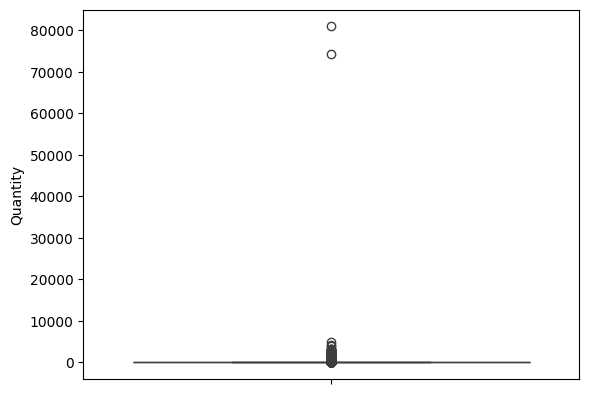

In [ ]:
# identificando Outliers em Quantity do Item acima de 10000

sns.boxplot(y=df['Quantity'], orient='v')
plt.yscale('linear')
plt.show()

In [ ]:
from scipy.stats import zscore
# Utilizando metodo Z-score para tratamento de Outliers
# https://stackoverflow.com/questions/24761998/pandas-compute-z-score-for-all-columns

# Calcular o Z-score para a coluna 'Quantity'
df['Quantity_zscore'] = zscore(df['Quantity'])

# Identificar e remover outliers com base no Z-score e na condição 'Quantity > 10000'
outliers_Qtd = df[(abs(df['Quantity_zscore']) > 3) & (df['Quantity'] > 10000)]

# Remover os outliers identificados do DataFrame original
# df_cleaned = df.drop(outliers.index)

# Exibir os outliers removidos
print(outliers_Qtd)

       InvoiceNo StockCode                     Description  Quantity  \
61619     541431     23166  MEDIUM CERAMIC TOP STORAGE JAR     74215   
540421    581483     23843     PAPER CRAFT , LITTLE BIRDIE     80995   

               InvoiceDate  UnitPrice  CustomerID         Country  \
61619  2011-01-18 10:01:00       1.04       12346  United Kingdom   
540421 2011-12-09 09:15:00       2.08       16446  United Kingdom   

        Quantity_zscore  
61619        411.107599  
540421       448.671465  


In [ ]:
# Visualizando numero de Outliers encontrado
num_outliers_Qtd = len(outliers_Qtd)
print("Número de outliers na coluna 'Quantity':", num_outliers_Qtd)

Número de outliers na coluna 'Quantity': 2


In [ ]:
# Remover os outliers identificados do DataFrame original
df_cleaned = df.drop(outliers_Qtd.index)

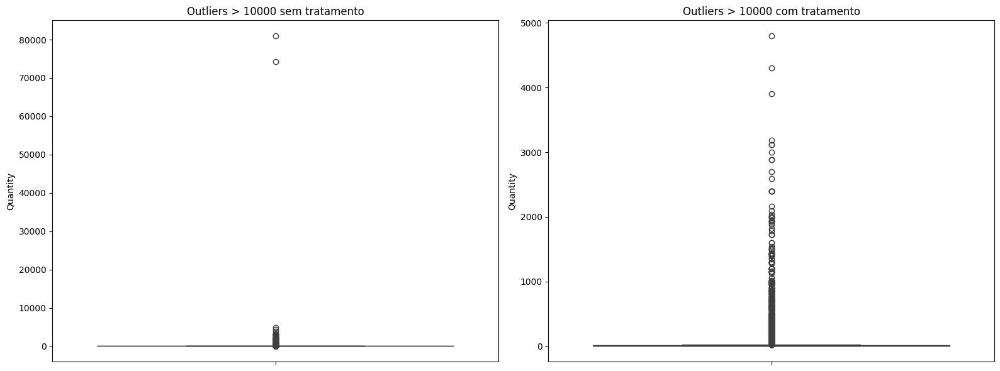

In [ ]:
# Criar uma figura e os subplots para os boxplots lado a lado
fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Boxplot da coluna 'Quantity' sem tratamento de outliers
sns.boxplot(y=df['Quantity'], orient='v', ax=axs[0])
axs[0].set_yscale('linear')
axs[0].set_title('Outliers > 10000 sem tratamento')

# Boxplot da coluna 'Quantity' com tratamento de outliers
sns.boxplot(y=df_cleaned['Quantity'], orient='v', ax=axs[1])
axs[1].set_yscale('linear')
axs[1].set_title('Outliers > 10000 com tratamento')

# Exibir os boxplots lado a lado
plt.tight_layout()
plt.show()

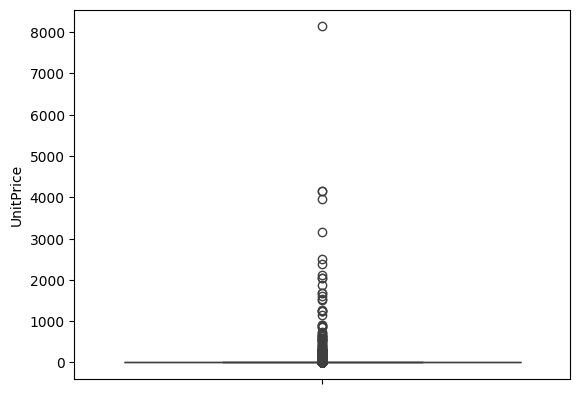

In [ ]:
# identificando Outliers na coluna UnitPrice acima de 5000

sns.boxplot(y=df['UnitPrice'], orient='v')
plt.yscale('linear')
plt.show()

In [ ]:
# Calcular o Z-score para a coluna 'UnitPrice'
df_cleaned['UnitPrice_zscore'] = zscore(df_cleaned['UnitPrice'])

# Identificar e remover outliers com base no Z-score e na condição 'UnitPrice' > 5000'
outliers_Price = df_cleaned[(abs(df_cleaned['UnitPrice_zscore']) > 3) & (df_cleaned['UnitPrice'] > 5000)]

num_outliers_Price = len(outliers_Price)
print("Número de outliers na coluna 'unitprice':", num_outliers_Price)


Número de outliers na coluna 'unitprice': 1


In [ ]:
# Removendo Outlier
df_cleaned = df_cleaned.drop(outliers_Price.index)

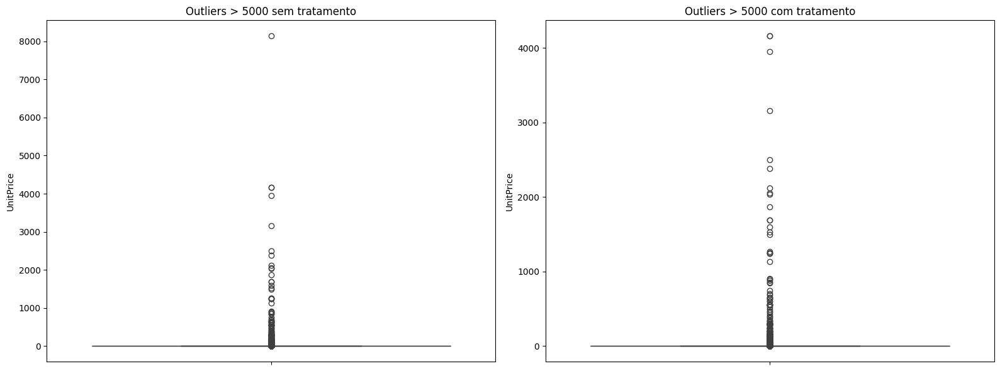

In [ ]:
# Criar uma figura e os subplots para os boxplots lado a lado
fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Boxplot da coluna 'UnitPrice' sem tratamento de outliers
sns.boxplot(y=df['UnitPrice'], orient='v', ax=axs[0])
axs[0].set_yscale('linear')
axs[0].set_title('Outliers > 5000 sem tratamento')

# Boxplot da coluna 'UnitPrice' com tratamento de outliers
sns.boxplot(y=df_cleaned['UnitPrice'], orient='v', ax=axs[1])
axs[1].set_yscale('linear')
axs[1].set_title('Outliers > 5000 com tratamento')

# Exibir os boxplots lado a lado
plt.tight_layout()
plt.show()

# 6 Preço Total da Compra
    Criando Coluna adicional

In [ ]:
# Criando coluna Total de compras :Total Purchase = Quantity * UnitPrice

df_cleaned['Total Purchase'] = df_cleaned['Quantity'] * df_cleaned['UnitPrice']
df_cleaned.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Quantity_zscore,UnitPrice_zscore,Total Purchase
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,-0.039446,-0.025894,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,-0.039446,0.011873,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,-0.028365,-0.016902,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,-0.039446,0.011873,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,-0.039446,0.011873,20.34


# 7 Data da ultima compra

In [ ]:
# Calculando a data da ultima compra no dataframe
df_cleaned['InvoiceDate'].max()

Timestamp('2011-12-09 12:50:00')

# 8 Plotando Gráficos
  Top 10 países com maior valor em vendas;
  Top 10 produtos mais vendidos;
  Valor de venda total por mês;
  Valor de venda total por mês e por país;

Top 10 Países em Vendas

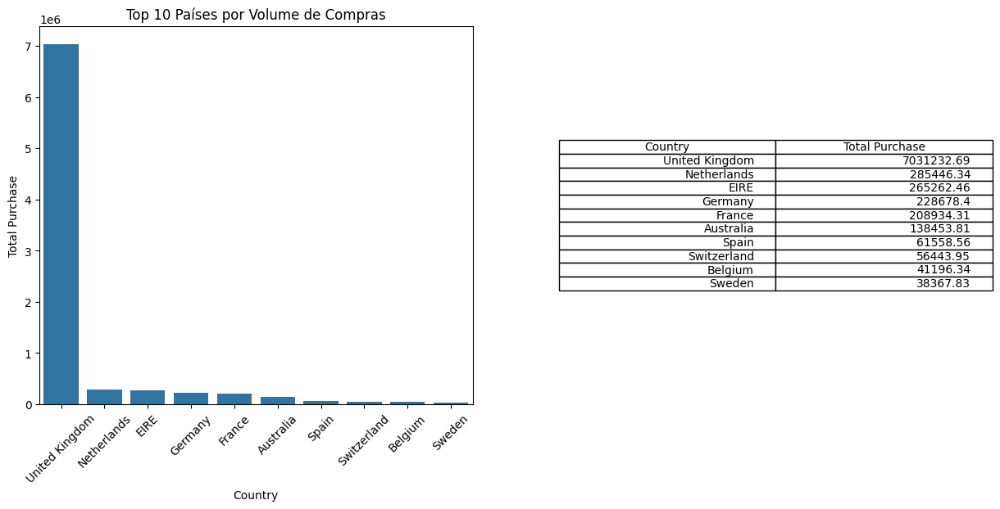

In [ ]:
# Grafico Top 10 Paises em Valor de vendas

#top_CountrySales = df_cleaned.groupby('Country').agg.({'Total Purchase': 'sum'}).reset_index()
top_CountrySales = df_cleaned.groupby('Country').agg({'Total Purchase': 'sum'}).reset_index()
top_CountrySales = top_CountrySales.sort_values(by='Total Purchase', ascending=False).head(10)
top_CountrySales

# Criar a figura com dois subplots lado a lado
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plotar o gráfico de barras no primeiro subplot
sns.barplot(x='Country', y='Total Purchase', data=top_CountrySales, ax=ax1)
ax1.set_xlabel('Country')
ax1.set_ylabel('Total Purchase')
ax1.set_title('Top 10 Países por Volume de Compras')
ax1.tick_params(axis='x', rotation=45)

# Mostrar a tabela no segundo subplot
ax2.axis('off')  # Para ocultar os eixos
ax2.table(cellText=top_CountrySales.values, colLabels=top_CountrySales.columns, loc='center')
plt.show()

Tope 10 Produtos mais vendidos

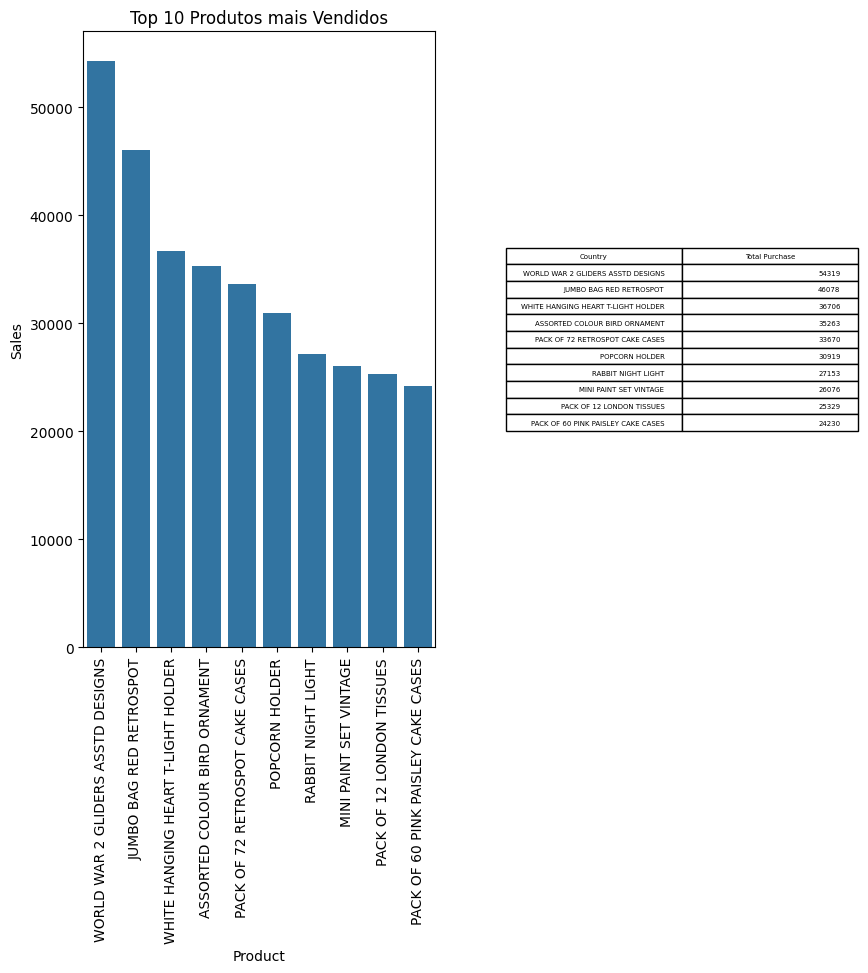

In [ ]:
# Top 10 Produtos mais Vendidos
#top_ProductSales = df_cleaned.groupby('').agg.({'Total Purchase': 'sum'}).reset_index()
top_ProductSales = df_cleaned.groupby('Description').agg({'Quantity': 'sum'}).reset_index()
top_ProductSales = top_ProductSales.sort_values(by='Quantity', ascending=False).head(10)
top_ProductSales

# Criar a figura com dois subplots lado a lado
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 8))

# Plotar o gráfico de barras no primeiro subplot

sns.barplot(x='Description', y='Quantity', data=top_ProductSales, ax=ax1,)
ax1.set_xlabel('Product')
ax1.set_ylabel('Sales')
ax1.set_title('Top 10 Produtos mais Vendidos')
ax1.tick_params(axis='x', rotation=90, )
# Mostrar a tabela no segundo subplot
ax2.axis('off')  # Para ocultar os eixos
ax2.table(cellText=top_ProductSales.values, colLabels=top_CountrySales.columns, loc='center')
plt.show()

Vendas Por Mês

In [ ]:
# Separar a data em ano e mês
df_cleaned['Year'] = df_cleaned['InvoiceDate'].dt.year
df_cleaned['Month'] = df_cleaned['InvoiceDate'].dt.month

# Criar uma nova coluna com a combinação de ano e mês para facilitar a análise
df_cleaned['YearMonth'] = df_cleaned['Year'].astype(str) + '-' + df_cleaned['Month'].astype(str)

# Calcular o total de compras por mês
Sales_Month = df_cleaned.groupby('YearMonth').agg({'Total Purchase': 'sum'}).reset_index()
Sales_Month

,YearMonth,Total Purchase
0,2010-12,570422.73
1,2011-1,490917.71
2,2011-10,1035642.45
3,2011-11,1156205.61
4,2011-12,348720.84
5,2011-2,446084.92
6,2011-3,594081.76
7,2011-4,468375.33
8,2011-5,669212.40
9,2011-6,660046.05


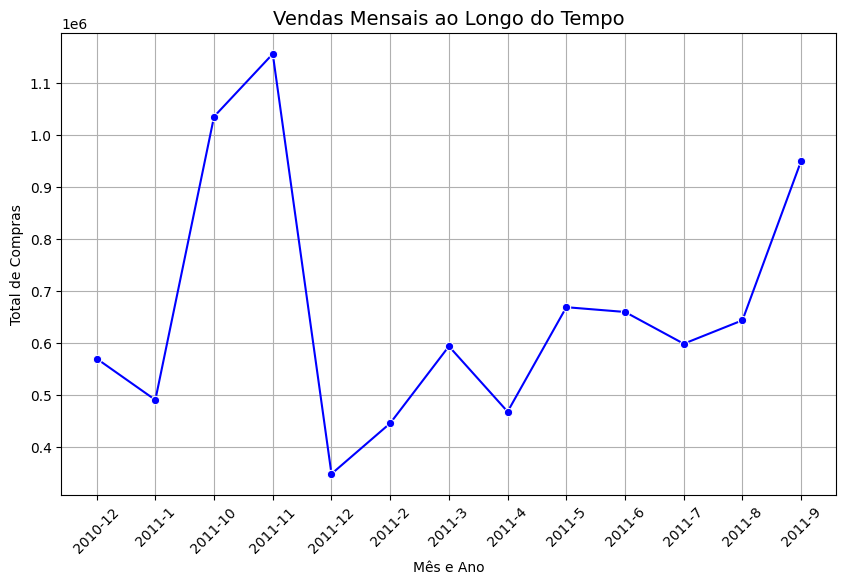

In [ ]:
# Criar o gráfico de vendas por mês
plt.figure(figsize=(10, 6))
sns.lineplot(x='YearMonth', y='Total Purchase', data=Sales_Month, marker='o', color='b')

plt.xlabel('Mês e Ano', fontsize=10)
plt.ylabel('Total de Compras', fontsize=10)
plt.title('Vendas Mensais ao Longo do Tempo', fontsize=14)
plt.xticks(rotation=45)
plt.grid(True)

plt.show()

In [ ]:
# Somente limpando dataframe das colunas sem utilidade

df_cleaned = df_cleaned.drop(['Quantity_zscore', 'UnitPrice_zscore'], axis=1)
df_cleaned.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Total Purchase,Year,Month,YearMonth
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850,United Kingdom,15.30,2010,12,2010-12
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,20.34,2010,12,2010-12
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850,United Kingdom,22.00,2010,12,2010-12
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,20.34,2010,12,2010-12
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850,United Kingdom,20.34,2010,12,2010-12


In [ ]:
# Grafico vendas por mês por país
Sales_MonthCountry = df_cleaned.groupby(['Month', 'Country'])['Total Purchase'].sum().reset_index()
Sales_MonthCountry = Sales_MonthCountry.sort_values(by='Total Purchase', ascending=False).reset_index(drop=True)
Sales_MonthCountry


,Month,Country,Total Purchase
0,11,United Kingdom,975251.39
1,10,United Kingdom,821220.13
2,12,United Kingdom,799389.56
3,9,United Kingdom,794808.69
4,5,United Kingdom,542216.60
...,...,...,...
266,10,Israel,132.18
267,9,Japan,112.08
268,8,Canada,51.56
269,3,Japan,48.90


# 10 Cálculo do RFM


Calculando a Recencia dos clientes

In [ ]:
# Calculando a recencia:
# Calcular a recência com base na data da última compra de cada cliente
last_purchase_date = df_cleaned.groupby('CustomerID')['InvoiceDate'].max().reset_index()
last_purchase_date.columns = ['CustomerID', 'LastPurchaseDate']

In [ ]:
# Calcular a data de referência para a análise
reference_date = df_cleaned['InvoiceDate'].max()

In [ ]:
# Calcular a recência em dias em relação à data de referência
last_purchase_date['Recency'] = (reference_date - last_purchase_date['LastPurchaseDate']).dt.days
last_purchase_date

,CustomerID,LastPurchaseDate,Recency
0,12347,2011-12-07 15:52:00,1
1,12348,2011-09-25 13:13:00,74
2,12349,2011-11-21 09:51:00,18
3,12350,2011-02-02 16:01:00,309
4,12352,2011-11-03 14:37:00,35
...,...,...,...
4332,18280,2011-03-07 09:52:00,277
4333,18281,2011-06-12 10:53:00,180
4334,18282,2011-12-02 11:43:00,7
4335,18283,2011-12-06 12:02:00,3


Calculando Frequência de compra dos clientes

In [ ]:
# Calcular a Frenquencia dos clientes:
frequency_sales = df_cleaned.groupby('CustomerID')['InvoiceDate'].nunique().reset_index()
frequency_sales.columns = ['CustomerID', 'Frequency']
frequency_sales

,CustomerID,Frequency
0,12347,7
1,12348,4
2,12349,1
3,12350,1
4,12352,8
...,...,...
4332,18280,1
4333,18281,1
4334,18282,2
4335,18283,16


Ticket Médio dos Clientes

In [ ]:
# Calculando ticket medio de comprar por cliente

average_ticket =df_cleaned.groupby('CustomerID')['Total Purchase'].mean().reset_index()
average_ticket.columns = ['CustomerID', 'AverageTicket']
average_ticket

,CustomerID,AverageTicket
0,12347,23.681319
1,12348,57.975484
2,12349,24.076027
3,12350,19.670588
4,12352,29.482824
...,...,...
4332,18280,18.060000
4333,18281,11.545714
4334,18282,14.837500
4335,18283,2.837074


# 11 Verificação de Relatorio

In [ ]:
profile = ProfileReport(df_cleaned, title='Relatório de Perfil', explorative=True)
profile.to_widgets()
profile

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:533: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  warnings.warn(


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]